<img src="https://worldwidestereo-weblinc.netdna-ssl.com/media/W1siZiIsIjIwMjAvMDYvMTYvMTIvMDAvMzMvNi8yMDIwMDYwNV9XRUJfSGVhZHBob25lX0J1eWluZ19HdWlkZV9CbG9nX0hlYWRlci5qcGciXV0/20200605-WEB-Headphone-Buying-Guide-Blog-Header.jpg?sha=d57c8b9634307258">

### <center> <b>Creating Playlists Using Clustering Techniques</b>

## Introduction

The online audio streaming market continues to experience signifcant growth. Spotify (currently  valued at over 40 billion) has become a dominant platform in this space by creating a superior user experience. One of the ways they have accomplished this is by curating popular playlists, eliminating the need for users to have to search Spotify's vast library for new music on their own. 

Given the massive volume of the Spotify library, Spotify likely uses machine learning clustering to group songs with similar properties into categories and playlist. 


## The Question

Using track audio features data from the Spotify API, is it possle to use unsupervised machine learning methods to create playlists of similiar songs?


## The Data

The data is a sample from a larger Kaggle dataset titled <a href = 'https://www.kaggle.com/saurabhshahane/spotgen-music-dataset'>Spotify and Genius Track Dataset</a>. The dataset I will be working with contains 22,000 observations and 32 variables.

The data was collected from the Spotify API. I will be using a subsample of the <i>spotify_tracks.csv</i> file, which contains track audio features. 


###  The Features

The audio features include things like:

<b>acousticness</b>

A confidence measure from 0.0 to 1.0 of whether the track is acoustic. 1.0 represents high confidence the track is acoustic.

----------------------------------------------------------------------------------------------------------------------

<b>danceability</b>

Danceability describes how suitable a track is for dancing based on a combination of musical elements including tempo, rhythm stability, beat strength, and overall regularity. A value of 0.0 is least danceable and 1.0 is most danceable.

----------------------------------------------------------------------------------------------------------------------

<b>liveness</b>

Detects the presence of an audience in the recording. Higher liveness values represent an increased probability that the track was performed live. A value above 0.8 provides strong likelihood that the track is live.

----------------------------------------------------------------------------------------------------------------------

A full description of the track audio features can be found here: https://developer.spotify.com/documentation/web-api/reference/#/operations/get-audio-features

In [1]:
#setting up the environment
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import MiniBatchKMeans
from sklearn.cluster import DBSCAN
from sklearn.mixture import GaussianMixture
from sklearn.manifold import TSNE
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.model_selection import train_test_split
from sklearn import datasets, metrics
#installing UMAP
!pip install umap-learn
import umap
! pip install yellowbrick
from yellowbrick.cluster import KElbowVisualizer
from yellowbrick.cluster import SilhouetteVisualizer

# Reading in the data
music_df = pd.read_parquet('https://raw.githubusercontent.com/JREnglish99/thinkful-data-science/main/challanges/data/spotify_tracks_trim_sample.parquet')

In [2]:
#exploring the data
music_df.shape

(22000, 32)

In [3]:
music_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 22000 entries, 31271 to 99619
Data columns (total 32 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         22000 non-null  int64  
 1   acousticness       22000 non-null  float64
 2   album_id           22000 non-null  object 
 3   analysis_url       22000 non-null  object 
 4   artists_id         22000 non-null  object 
 5   available_markets  22000 non-null  object 
 6   country            22000 non-null  object 
 7   danceability       22000 non-null  float64
 8   disc_number        22000 non-null  float64
 9   duration_ms        22000 non-null  float64
 10  energy             22000 non-null  float64
 11  href               22000 non-null  object 
 12  id                 22000 non-null  object 
 13  instrumentalness   22000 non-null  float64
 14  key                22000 non-null  float64
 15  liveness           22000 non-null  float64
 16  loudness          

There appears to be no null variables in this dataset 

In [4]:
music_df.head(5)

,Unnamed: 0,acousticness,album_id,analysis_url,artists_id,available_markets,country,danceability,disc_number,duration_ms,...,preview_url,speechiness,tempo,time_signature,track_href,track_name_prev,track_number,uri,valence,type
31271,31271,0.567,4Ol6h6D8OdsFju6ks2HFbh,https://api.spotify.com/v1/audio-analysis/3zKH...,"['6MDME20pz9RveH9rEXvrOM', '0ZED1XzwlLHW4ZaG4l...","['AD', 'AE', 'AR', 'AT', 'AU', 'BE', 'BG', 'BH...",BE,0.659,1.0,250252.0,...,https://p.scdn.co/mp3-preview/7c92528a2f80fc74...,0.0543,160.056,4.0,https://api.spotify.com/v1/tracks/3zKHw6cGxDZs...,track_12,1.0,spotify:track:3zKHw6cGxDZsqUyiGPwFca,0.537,track
30641,30641,0.549,3Elu6BGN5g2f8nMrvi9zp6,https://api.spotify.com/v1/audio-analysis/62XC...,['5Hr6G2HwK68ZhkjPMwJgrB'],"['AD', 'AE', 'AR', 'AT', 'AU', 'BE', 'BG', 'BH...",FI,0.690,1.0,188800.0,...,https://p.scdn.co/mp3-preview/3af73f8ea455150e...,0.0381,96.021,4.0,https://api.spotify.com/v1/tracks/62XCV8NgBmhU...,track_16,4.0,spotify:track:62XCV8NgBmhUOTJcK7nSDa,0.965,track
9174,9174,0.950,5Br5gVFiX5qaUUfHRVkxPj,https://api.spotify.com/v1/audio-analysis/2lu5...,['3UbPiAHODPHyrORJPMPnEG'],"['AD', 'AE', 'AR', 'AT', 'AU', 'BE', 'BG', 'BH...",FI,0.631,1.0,342427.0,...,https://p.scdn.co/mp3-preview/ccf862e717354d1e...,0.9500,90.044,4.0,https://api.spotify.com/v1/tracks/2lu5b2G7wxrM...,track_96,20.0,spotify:track:2lu5b2G7wxrMLSyQTsbDDf,0.178,track
68666,68666,0.823,5Bj0dPZyNYKix5Uc19aLbx,https://api.spotify.com/v1/audio-analysis/6X3c...,['4bUFcghVJHLp2HSaEJTtyd'],"['AD', 'AE', 'AR', 'AT', 'AU', 'BE', 'BG', 'BH...",AR,0.712,1.0,49987.0,...,https://p.scdn.co/mp3-preview/1cc05cbc4c3898ff...,0.8980,85.571,3.0,https://api.spotify.com/v1/tracks/6X3cpaBgC7il...,track_40,14.0,spotify:track:6X3cpaBgC7il18fyX8b4Zy,0.354,track
73949,73949,0.111,1a8fsoazUIuuoxhs1HPrWH,https://api.spotify.com/v1/audio-analysis/6AHL...,['3YPzVOVeAXdzhmnffu1WjZ'],"['AD', 'AE', 'AR', 'AT', 'AU', 'BE', 'BG', 'BH...",AR,0.562,1.0,207043.0,...,https://p.scdn.co/mp3-preview/95f0644860903f2a...,0.0937,138.007,4.0,https://api.spotify.com/v1/tracks/6AHLWcxciUvg...,track_36,1.0,spotify:track:6AHLWcxciUvgBy2WQSvmu3,0.420,track


In [5]:
#checking number of unique observations for each variabele
music_df.nunique()

Unnamed: 0           22000
acousticness          3487
album_id             19325
analysis_url         22000
artists_id           16247
available_markets     1204
country                  3
danceability           980
disc_number             12
duration_ms          18051
energy                1680
href                 22000
id                   22000
instrumentalness      4353
key                     12
liveness              1579
loudness             11723
lyrics               13324
mode                     2
name                 20657
playlist              3495
popularity              94
preview_url          21895
speechiness           1519
tempo                17046
time_signature           5
track_href           22000
track_name_prev        100
track_number            88
uri                  22000
valence               1531
type                     1
dtype: int64

In [6]:
music_df.country.unique()

array(['BE', 'FI', 'AR'], dtype=object)

## The Method 

For this analysis, I will attempt tune and evaluate several clustering models with the goal of identifying songs of similiar types. While I will not have perfectly defineid ground truths, I do want to try to identify tracks that would fall into at least two playlists: a party playlist and a relaxing playlist. 

First, I will first drop variables and observations that are not useful. Then I will use some of the remaining variables to create features that score the tracks for the party and relaxing playlists. 

Next, I will use dimesionality reduction techiniques to help with visualizing clusters in 2 dimensional space. I will try PCA and UMAP dimensionality reduction methods experiment with different UMAP parameters to create the most clear visualization possible. This will help with evaluation in the next step. 

I will then run, tune and evaluate several clustering models. I will experiment with several hyperparemeters within each model. Since I do not have full ground truth targets, I will use silhouette score to evaluate performance. 

Finally, I will see if clusters can help identify tracks that would be good to add to my playlists. I will also try to identify the qualities of any additional clusters that are generated in the process. 

In [7]:
#dropping variables that are not useable
drop_list = ['Unnamed: 0','album_id', 'analysis_url', 'disc_number', 'href', 'id', 'lyrics', 'name', 'playlist', 'artists_id', 'preview_url', 'track_href', 'track_name_prev', 'track_number', 'uri', 'type']

In [8]:
music_df = music_df.drop(drop_list, axis=1)

In [9]:
music_df.head(5)

,acousticness,available_markets,country,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo,time_signature,valence
31271,0.567,"['AD', 'AE', 'AR', 'AT', 'AU', 'BE', 'BG', 'BH...",BE,0.659,250252.0,0.5020,0.000496,7.0,0.128,-7.223,0.0,55.0,0.0543,160.056,4.0,0.537
30641,0.549,"['AD', 'AE', 'AR', 'AT', 'AU', 'BE', 'BG', 'BH...",FI,0.690,188800.0,0.8970,0.000000,7.0,0.361,-3.252,1.0,31.0,0.0381,96.021,4.0,0.965
9174,0.950,"['AD', 'AE', 'AR', 'AT', 'AU', 'BE', 'BG', 'BH...",FI,0.631,342427.0,0.4400,0.000002,9.0,0.117,-12.966,0.0,2.0,0.9500,90.044,4.0,0.178
68666,0.823,"['AD', 'AE', 'AR', 'AT', 'AU', 'BE', 'BG', 'BH...",AR,0.712,49987.0,0.0912,0.000000,11.0,0.567,-23.488,0.0,4.0,0.8980,85.571,3.0,0.354
73949,0.111,"['AD', 'AE', 'AR', 'AT', 'AU', 'BE', 'BG', 'BH...",AR,0.562,207043.0,0.8480,0.000000,9.0,0.208,-5.655,1.0,23.0,0.0937,138.007,4.0,0.420


### Further EDA

I want to further explore the data to see if I am missing anything such as non-null values that don't make sense. One way to quickly evaluate this is to use boxblots to visualize outliers.

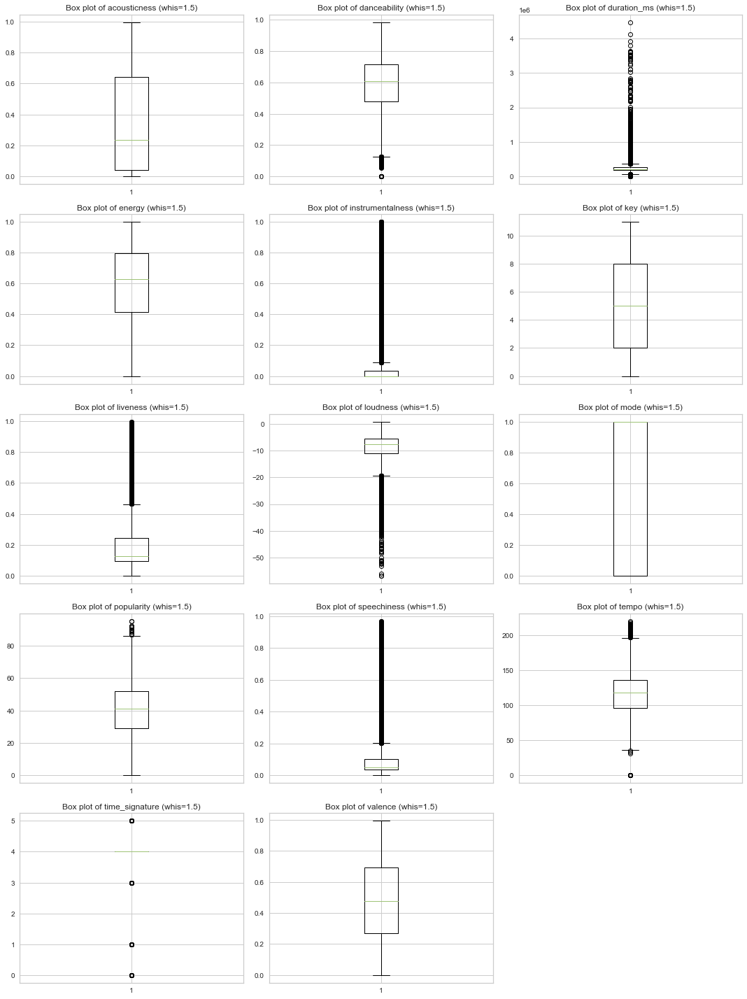

In [10]:
#setting up box-plots
plt.figure(figsize=(15,20))

index = 1

for column in music_df.select_dtypes(['int64', 'float64']).columns:
  plt.subplot(5,3,index)
  plt.boxplot(music_df.select_dtypes(['int64', 'float64'])[column])
  plt.title("Box plot of {} (whis=1.5)" .format(column))
  index = index + 1
plt.tight_layout()
plt.show()

There does appear to be some datapoints worth descarding, such as tracks with very short durations, songs with temp and time signaturs of zero and songs with no popularity score.

In [11]:
#dropping the rows mentioned above
music_df = music_df[music_df.duration_ms >= 30000]
music_df = music_df[music_df.popularity != 0]
music_df = music_df[music_df.tempo != 0]
music_df = music_df[music_df.time_signature != 0]

I will also remove tracks that are likely to be non-music, like podcasts or spoken word clips.

In [12]:
music_df = music_df[music_df.speechiness <= .66]

In [13]:
#dropping the time_signature variable
music_df = music_df.drop('time_signature', axis=1)

### Creating Features

I want to drop songs that are only available in a single market because I want all the tracks in the playlists I find to be avialable to a broad audience. 

In [14]:
#changing the string objects to lists
market_list = music_df.available_markets.apply(eval)

#sertting the list up as a separate dataframe
market_list = pd.DataFrame(market_list)

#getting the length of each list
empty = []
for row in market_list.index:
    market_count = len(market_list.loc[row, 'available_markets'])
    empty.append(market_count)
    
#adding the new feature to the dataframe
music_df['markets_count'] = empty

#dropping the old variable
music_df = music_df.drop('available_markets', axis=1)

In [15]:
music_df['markets_count'].describe()

count    20715.000000
mean        72.198069
std         19.503824
min          1.000000
25%         78.000000
50%         79.000000
75%         79.000000
max         79.000000
Name: markets_count, dtype: float64

In [16]:
#removing tracks only available in 1 market
music_df = music_df[music_df['markets_count'] !=1]

## The Playlists Targets

Since I want to create playlists for specific moods (party and relax), I want to create scores that rank the tracks based on how well the tracks fit those moods. This is a bit subjective and would require some domain knowledge in a real world scenario. I will attempt to use my limited knowledge in the space by assuming the following:

<ul>
<li>A good song for my party playlist would be energetic and danceable.</li>
<li>A good song for my relaxing playlist would have low energy, lower volume and more acousticness.</li>
<li>For the purpose of this project, all playlists shuold be made up of songs that are relatively popular.</li>
</ul>

In [17]:
#creating a party score
music_df['party_score'] = music_df['danceability'] + music_df['energy']

In [18]:
#creating a relax score
music_df['relax_score'] = (music_df['energy'] + music_df['loudness'])-music_df['acousticness']

Below I am creating labels for tracks that meet a certain score thresholds for party tracks and relaxing tracks. However, I only want to have the most popular songs in the dataset on my playlists and I am open to finding additional playlist clusters.

In [19]:
#marking the top 25 percentile of party score, party tracks and the bottom 25% of relax score relax tracks (negative score)
music_df.loc[music_df['party_score'] >= np.percentile(music_df['party_score'], 75, axis=0), 'playlist_class'] = 'party_track'
music_df.loc[music_df['relax_score'] <= np.percentile(music_df['relax_score'], 25, axis=0), 'playlist_class'] = 'relax_track'

In [20]:
#labeling nulls in playlist class
music_df["playlist_class"].fillna("other", inplace = True)

In [21]:
#breaking popularity into three levels
cut_labels_popularity = ['not_popular', 'could_be_popular', 'popular']
music_df['popularity_ranking'] = pd.qcut(music_df['popularity'], q=3, labels=cut_labels_popularity)


In [22]:
music_df.head()

,acousticness,country,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo,valence,markets_count,party_score,relax_score,playlist_class,popularity_ranking
31271,0.567,BE,0.659,250252.0,0.502,0.000496,7.0,0.1280,-7.223,0.0,55.0,0.0543,160.056,0.5370,78,1.161,-7.288,other,popular
30641,0.549,FI,0.690,188800.0,0.897,0.000000,7.0,0.3610,-3.252,1.0,31.0,0.0381,96.021,0.9650,79,1.587,-2.904,party_track,not_popular
73949,0.111,AR,0.562,207043.0,0.848,0.000000,9.0,0.2080,-5.655,1.0,23.0,0.0937,138.007,0.4200,79,1.410,-4.918,other,not_popular
32242,0.376,FI,0.710,195960.0,0.489,0.000000,4.0,0.0981,-10.224,0.0,57.0,0.1780,130.057,0.0767,79,1.199,-10.111,other,popular
30407,0.363,FI,0.753,207023.0,0.687,0.000000,10.0,0.1480,-5.364,0.0,39.0,0.3300,158.143,0.4130,79,1.440,-5.040,party_track,could_be_popular


At this point, I am ready to move forward with visualizing via dimensionality reduction and testing clustering models.

In [23]:
# Defining X
X = music_df.filter(['instrumentalness', 'liveness', 'valence', 'mode', 'popularity_ranking', 'playlist_class'], axis=1)

In [24]:
X = pd.get_dummies(X)

In [25]:

# Standardizing the features
scaler = StandardScaler()
X_std = scaler.fit_transform(X)

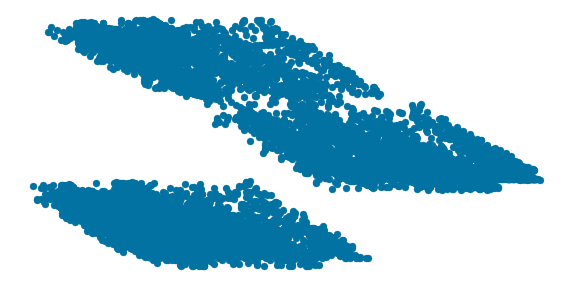

In [26]:
# visualizing with PCA
pca = PCA(n_components=2)

# Get the components by 
# calling `fit_transform()` method with the data
pca_components = pca.fit_transform(X_std)

plt.figure(figsize=(10,5))
plt.scatter(pca_components[:, 0], pca_components[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.show()

There appears to be some potentially usefull clusters but they are very hard to see with PCA. 

UMAP is fast and works well for nonlinear dimension reduction.

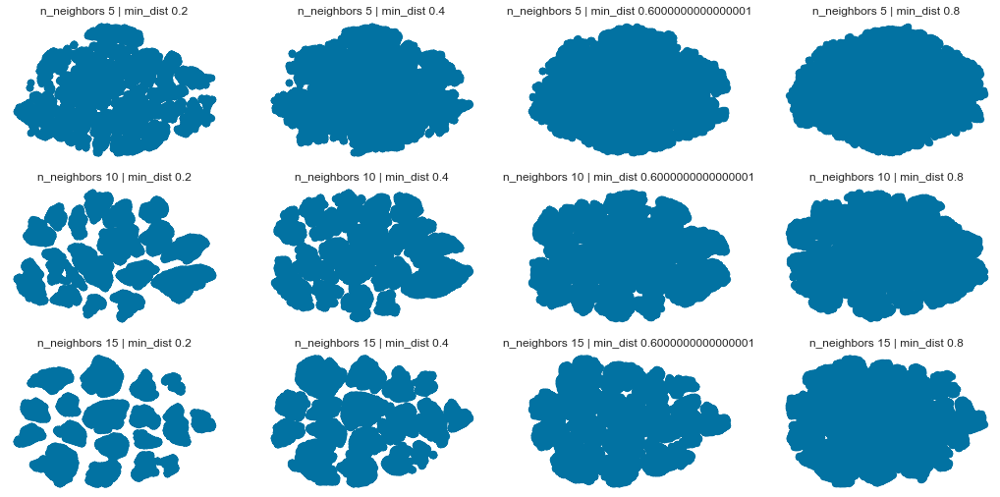

In [27]:
# Testing different tuning fot UMAP
plt.figure(figsize=(18,15))
count = 1
for neighbs in range(5,20,5):
  for mins in np.arange(0.2,1.0,0.2):
    umap_results = umap.UMAP(n_neighbors=neighbs,
                      min_dist=mins,
                      metric='correlation').fit_transform(X_std)
    plt.subplot(5,4,count)
    plt.scatter(umap_results[:, 0], umap_results[:, 1])
    plt.xticks([])
    plt.yticks([])
    plt.axis('off')
    plt.title("n_neighbors {} | min_dist {}" .format(neighbs, mins))
    count +=1

plt.show()

Tuning the hyperparameters to n_neighbors 15 and min_dist 0.2 produces a clean vizualization, which we will be useful moving forward.

In [28]:
umap_results = umap.UMAP(n_neighbors=15,
                      min_dist=0.2,
                      metric='correlation').fit_transform(X_std)

(-12.684319734573364,
 22.33018136024475,
 -12.623612642288208,
 20.771629571914673)

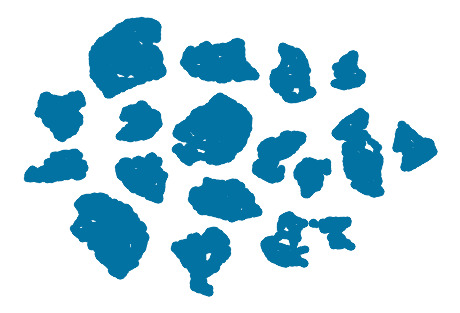

In [29]:

plt.scatter(umap_results[:, 0], umap_results[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')

## Testing the Models
I will now begin testing the models using the features and visualization above. I will use:

<ul>
    <li>K-Means</li>
    <li>Gaussian Mixture Model</li>
    <li>Agglomerative (bottom-up) Hierarchical Clustering</li>
</ul>


### Evaluating the Models
To evaluate the models, I will use the Silhouette Coefficient which compares intra-cluster distance and inter-cluster distance of the points of each cluster:

Silhouette Score = (b-a)/max(a,b)

where

a = the average distance between each point within a cluster.

b = the average distance between all clusters.

### K- Means

The first model I will test is K-means. K-means requires the following:

<ul>
<li>Cluster number is  𝑘 </li>

<li>Clusters are isotropic</li>

<li>Clusters have similar variance</li>
</ul>

### Finding the Right K Value

I will use the elbow method to find the optimal value for k.  

The elbow method plots a clustering score (in this case a distortion score) against an increasing number of cluster choices. 

The optimal value for k can be found at the the elbow of the curve.

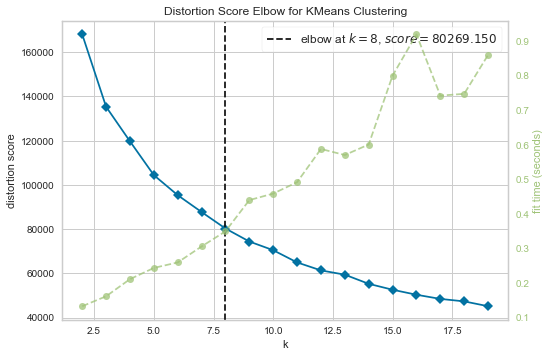

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [30]:
# Instantiate the clustering model and visualizer
model = KMeans()
visualizer = KElbowVisualizer(model, k=(2,20))

visualizer.fit(X_std)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

In [31]:
kmeans_cluster = KMeans(visualizer.elbow_value_, random_state=123)
k_labels = kmeans_cluster.fit_predict(X_std)


### Visualizing the Results
The the silhouette score for K means is 3.5. The Silhouette Visualizer below displays the silhouette coefficient for each sample on a per-cluster basis.

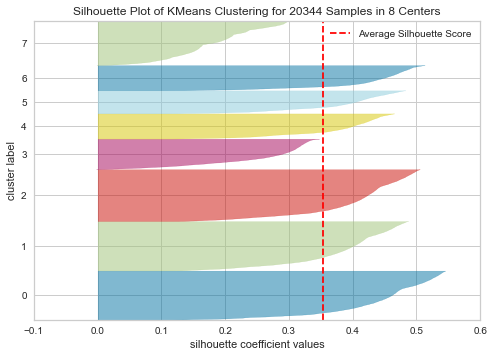

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 20344 Samples in 8 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [32]:

visualizer = SilhouetteVisualizer(kmeans_cluster, colors='yellowbrick')
visualizer.fit(X_std)
visualizer.show()

In [33]:
kmeans_cluster = KMeans(n_clusters=8, random_state=123)
kmeans_cluster.fit(X_std)
k_labels = kmeans_cluster.predict(X_std)

In [34]:
from sklearn.metrics import davies_bouldin_score
print('For K-Means: the S-Score is {} | the DB-Score is: {}' .format(metrics.silhouette_score(X_std, k_labels, metric='euclidean'), davies_bouldin_score(X_std, k_labels)))

For K-Means: the S-Score is 0.35399940443294226 | the DB-Score is: 1.3017986546926115


In [35]:
umap_results = umap.UMAP(n_neighbors=18,
                      min_dist=0.2,
                      metric='correlation').fit_transform(X_std)


colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(umap_results.shape[0]):
    plt.text(umap_results[i, 0], umap_results[i, 1], str(k_labels[i]),
             color=colours[k_labels[i]],
             fontdict={'weight': 'bold', 'size': 50})

### Gaussian Mixture Model

Next up is the Gaussian Mixture Model. GMM generate clusters by assuming that the data is generated by a mixture of several Gaussian (normal) distributions. 

For GMM, I will run the model several times and determine the best number of clusters by using the highest silhouette score.  

In [36]:
for c in range(6,16):
  gmm_cluster = GaussianMixture(n_components=c, random_state=123)
  g_labels = gmm_cluster.fit_predict(X_std)
  print('For {} clusters: the S-Score is {} | the DB-Score is: {}' .format(c, metrics.silhouette_score(X_std, g_labels, metric='euclidean'), davies_bouldin_score(X_std, g_labels)))

For 6 clusters: the S-Score is 0.30256666274788585 | the DB-Score is: 1.328512731620964
For 7 clusters: the S-Score is 0.3024281272700133 | the DB-Score is: 1.461899553568724
For 8 clusters: the S-Score is 0.34977995753562596 | the DB-Score is: 1.3955220590425292
For 9 clusters: the S-Score is 0.34675396227527605 | the DB-Score is: 1.4572017004258941
For 10 clusters: the S-Score is 0.36038176269883915 | the DB-Score is: 1.3287627129215775
For 11 clusters: the S-Score is 0.339239320648037 | the DB-Score is: 1.3123824430800923
For 12 clusters: the S-Score is 0.3384893639489744 | the DB-Score is: 1.3144185767026073
For 13 clusters: the S-Score is 0.3357522476959007 | the DB-Score is: 1.332862164234676
For 14 clusters: the S-Score is 0.33168255422729087 | the DB-Score is: 1.3250722510394048
For 15 clusters: the S-Score is 0.33240184022410546 | the DB-Score is: 1.3290621200668684


### Visualizing the GMM Results

This time, the highest silhouette was .36 and indicates that 10 clusters is better than the 8 identified by k means.

In [37]:
gmm_cluster = GaussianMixture(n_components=10, random_state=123)
g_labels = gmm_cluster.fit_predict(X_std)


umap_results = umap.UMAP(n_neighbors=18,
                      min_dist=0.2,
                      metric='correlation').fit_transform(X_std)

colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(umap_results.shape[0]):
    plt.text(umap_results[i, 0], umap_results[i, 1], str(g_labels[i]),
             color=colours[g_labels[i]],
             fontdict={'weight': 'bold', 'size': 50})

### Hierarchical Clustering

I will now try agglomerative (bottom-up) hierarchical clustering. These models build a treelike hierarchy of clusters within the data.


In [39]:
# Defining the Hierarchical - agglomerative clustering
linkage_type = ['complete', 'average']
affinity_type = ['euclidean', 'manhattan', 'cosine']
for link in linkage_type:
  for aff in affinity_type:
    for c in range(8,12):
      agg_cluster = AgglomerativeClustering(linkage=link, 
                                      affinity=aff,
                                      n_clusters=c)
      agg_labels = agg_cluster.fit_predict(X_std)
      print('For l_type {}, a_type {}, clusters {}: S-Score is {} | the DB-Score is: {}' .format(link, aff, c, metrics.silhouette_score(X_std, agg_labels, metric='euclidean'), davies_bouldin_score(X_std, agg_labels)))

For l_type complete, a_type euclidean, clusters 8: S-Score is 0.2036797867838244 | the DB-Score is: 1.6416975436296806
For l_type complete, a_type euclidean, clusters 9: S-Score is 0.15308125215823987 | the DB-Score is: 1.870112133865507
For l_type complete, a_type euclidean, clusters 10: S-Score is 0.14223398366568246 | the DB-Score is: 1.8883960420609818
For l_type complete, a_type euclidean, clusters 11: S-Score is 0.15648747588024395 | the DB-Score is: 1.8774178298140676
For l_type complete, a_type manhattan, clusters 8: S-Score is 0.2912745136941472 | the DB-Score is: 1.312236548152376
For l_type complete, a_type manhattan, clusters 9: S-Score is 0.3319850139283442 | the DB-Score is: 1.2607519243858742
For l_type complete, a_type manhattan, clusters 10: S-Score is 0.3301222064448244 | the DB-Score is: 1.234304967047816
For l_type complete, a_type manhattan, clusters 11: S-Score is 0.37547949726668195 | the DB-Score is: 1.1796560586509603
For l_type complete, a_type cosine, cluster

In [41]:
# Defining the agglomerative / Hierarchical clustering

for c in range(6,12):
    agg_cluster = AgglomerativeClustering(linkage='ward', affinity='euclidean', n_clusters=c)
    ward_labels = agg_cluster.fit_predict(X_std)
    print('For l_type ward, a_type euclidean, clusters {}: S-Score is {} | the DB-Score is: {}' .format(c, metrics.silhouette_score(X_std, ward_labels, metric='euclidean'), davies_bouldin_score(X_std, ward_labels)))

For l_type ward, a_type euclidean, clusters 6: S-Score is 0.24966254035779548 | the DB-Score is: 1.472507298600263
For l_type ward, a_type euclidean, clusters 7: S-Score is 0.2644164229092038 | the DB-Score is: 1.5249550068741606
For l_type ward, a_type euclidean, clusters 8: S-Score is 0.2894775149829765 | the DB-Score is: 1.5175859667523297
For l_type ward, a_type euclidean, clusters 9: S-Score is 0.31548203203444597 | the DB-Score is: 1.4941166311277483
For l_type ward, a_type euclidean, clusters 10: S-Score is 0.34048607220519894 | the DB-Score is: 1.4069323137667713
For l_type ward, a_type euclidean, clusters 11: S-Score is 0.3646690126894163 | the DB-Score is: 1.3271826896886283


### Visualizing the Agglomorative Model Results

The highest silhouette score was obtained with average linkage, cosine affinitey and 11 clusters. 

However, a very close second was found with 10 clusters. Since the difference was minimal, and GMM also had the highest silhouette score with 10 clusters, I will use 10 clusters.

In [42]:
agg_cluster = AgglomerativeClustering(linkage='average', affinity='cosine', n_clusters=10)
ac10_labels = agg_cluster.fit_predict(X_std)

umap_results = umap.UMAP(n_neighbors=18,
                      min_dist=0.2,
                      metric='correlation').fit_transform(X_std)

colours = ["r","b","g","c","m","y","k","r","burlywood","chartreuse"]
for i in range(umap_results.shape[0]):
    plt.text(umap_results[i, 0], umap_results[i, 1], str(ac10_labels[i]),
             color=colours[ac10_labels[i]],
             fontdict={'weight': 'bold', 'size': 50})

## Model Comparison and Selection
<ul>
<li>All of the models performed simalarly.</li>

<li>None of the scores indicated particularly strong clusters.</li>

<li>The model with the highest silhouette score is the Agglomertive model. </li>

<li>I will use the cluster results from this model as the assignments for my playlist selection. </li>
</ul>

In [43]:
#comparing the results of all the models
score_comparison = {'Results': ['Clusters', 'Silhouette Score'], 'K-Means': [8, 0.35], 'GMM': [10, 0.36], 'Agglomerative': [10 ,0.38]}
results = pd.DataFrame(data=score_comparison)

In [45]:
results

,Results,K-Means,GMM,Agglomerative
0,Clusters,8.00,10.00,10.00
1,Silhouette Score,0.35,0.36,0.38


In [46]:
music_df['cluster'] = ac10_labels

In [47]:
music_df.head()

,acousticness,country,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo,valence,markets_count,party_score,relax_score,playlist_class,popularity_ranking,cluster
31271,0.567,BE,0.659,250252.0,0.502,0.000496,7.0,0.1280,-7.223,0.0,55.0,0.0543,160.056,0.5370,78,1.161,-7.288,other,popular,2
30641,0.549,FI,0.690,188800.0,0.897,0.000000,7.0,0.3610,-3.252,1.0,31.0,0.0381,96.021,0.9650,79,1.587,-2.904,party_track,not_popular,9
73949,0.111,AR,0.562,207043.0,0.848,0.000000,9.0,0.2080,-5.655,1.0,23.0,0.0937,138.007,0.4200,79,1.410,-4.918,other,not_popular,1
32242,0.376,FI,0.710,195960.0,0.489,0.000000,4.0,0.0981,-10.224,0.0,57.0,0.1780,130.057,0.0767,79,1.199,-10.111,other,popular,2
30407,0.363,FI,0.753,207023.0,0.687,0.000000,10.0,0.1480,-5.364,0.0,39.0,0.3300,158.143,0.4130,79,1.440,-5.040,party_track,could_be_popular,8


In [48]:
for clus in music_df['cluster'].unique():
    cl = music_df[music_df['cluster'] == clus]
    print('For cluster {}' .format(clus))
    print(cl['popularity_ranking'].value_counts())
    print(cl['playlist_class'].value_counts())
    print('-----------------------------------------------------')

For cluster 2
popular             3192
not_popular            0
could_be_popular       0
Name: popularity_ranking, dtype: int64
other    3192
Name: playlist_class, dtype: int64
-----------------------------------------------------
For cluster 9
not_popular         1471
could_be_popular       0
popular                0
Name: popularity_ranking, dtype: int64
party_track    1471
Name: playlist_class, dtype: int64
-----------------------------------------------------
For cluster 1
not_popular         3166
could_be_popular       0
popular                0
Name: popularity_ranking, dtype: int64
other    3166
Name: playlist_class, dtype: int64
-----------------------------------------------------
For cluster 8
could_be_popular    1636
not_popular            0
popular                0
Name: popularity_ranking, dtype: int64
party_track    1636
Name: playlist_class, dtype: int64
-----------------------------------------------------
For cluster 3
could_be_popular    3309
not_popular            0


## Initial Results

Based on inspection of the labels, it appears the model was able to properly identiy the playlists I was looking for. The clusters can be described in the following way:

<ul>
<li>1 = Songs that are not popular and not party songs or relaxing songs</li>
<li>2 = Songs that are popular but are not party songs or relaxing songs</li>
<li>3 = Songs that are moderately popular but are not party songs or relaxing songs</li>
<li><b>4 = Songs that are popular and party songs</b></li>
<li>5 = Songs that moderately popular and relaxing songs</li>
<li>6 = Songs that are not popular but are relaxing</li>
<li><b>7 = Songs that are popular and are relaxing</b></li>
<li>8 = Songs that moderately popular and are party songs</li>
<li>9 = Songs that are not popular and are party songs</li>
<li>0 = A bit of a mystery - to be explored more below.</li>
</ul>

Clusters 4 and 7 are my target playlists. Clusters 5 and 8 are moderately popular variations of my target that could be their own playlists reccomendations - like discovery playlists for relaxing and party songs. 

## Further Exploration

Based on the results above, there are two clusters I want to know more about:

<ol>
    <li>Clusters marked 0 do not appear to have an obvious explanation</li>
    <li>Clusters marked 2 are poopular but don't fall into my target playlists</li>
</ol>

I will investigate these further below. 

In [49]:
explore_zero = music_df.select_dtypes(['int64', 'float64'])

In [50]:
#setting up a new dataframe
explore_zero = explore_zero.drop(['mode'], axis=1)

In [51]:
len(explore_zero.columns)

16

### Visualizing Clusters Against Each Feature

To quickly visually inspect the mystery clusters, I will plot them against each feature using boxplots

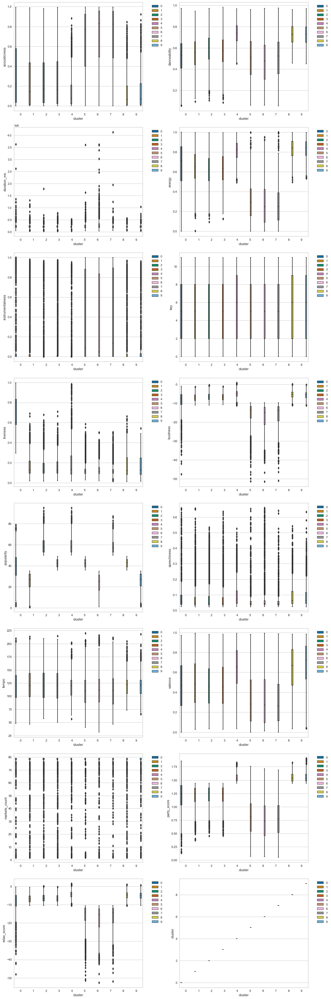

In [52]:
#visualizing the clusters against each of the features
plt.figure(figsize=(15,45))

counter = 1
for column in explore_zero.columns:
    plt.subplot(8,2,counter)
    sns.boxplot(y=column, x='cluster', 
                 data=explore_zero, 
                 palette="colorblind",
                 hue='cluster')
    plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
    counter +=1
plt.tight_layout()
plt.show()   

### Results of Further Exploration

Some interesting results here:
<ul>
<li>We can see that cluster 0 represents songs that are live recordings of music that is not party music or relaxing music. This could be a live music playlist.</li> 

<li>Also, cluster 5 is moderately popular, highly instrumental, and relaxing music. This could be a good study or focus playlist. </li>

<li>Cluster 2 remains a bit a mystery - perhaps the most simple answer is that these are standard pop songs, as they are popular tracks but don't stand out in any way when compared to the other features. </li>
</ul>

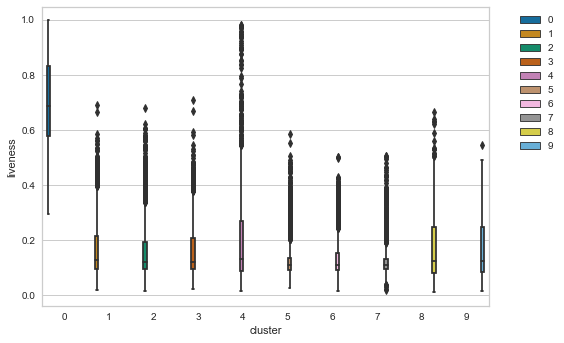

In [53]:
#showing cluster 0 is live music
sns.boxplot(y='liveness', x='cluster', 
                 data=music_df, 
                 palette="colorblind",
                 hue='cluster')

plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()  

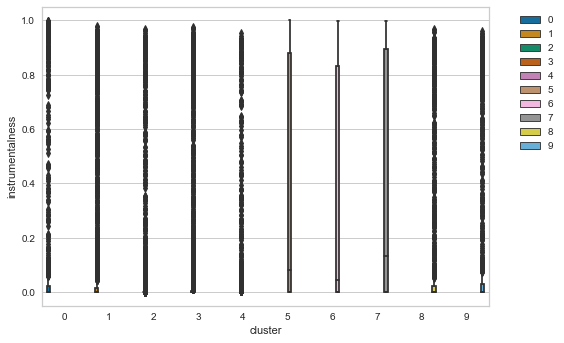

In [54]:
sns.boxplot(y='instrumentalness', x='cluster', 
                 data=music_df, 
                 palette="colorblind",
                 hue='cluster')

plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.show()  

## Final Results

The clustering was successful in identifying my target playlists and finding a couple of additional potential playlists including a live music playlist and an instrutmental relaxing playlist. 


## Discussion, Limitations and Recommendations

### Users
Audio streaming platforms, like Spotify, have changed the music industry in many ways. The data they capture, generate and share can be used for a variety of applications. 

For the purpose of this project, I was able to create some personal playlists. Other users or audiences could include spotify partner app developers and the music creaters themselves. 

Partner apps, could develop integrated playlists using this data to create playlists for their products. Paleton, for example, has a Spotify app that includes Paleton playlists. 

Music production companies could use this data to develop models to predict the popularity of the songs they are producing and tweak the songs they produce to match the trends.



### Limitations

I think the feature categories I created did a lot of heavy lifting for the clustering of the playlists I was looking for. It seems like most of the clusters were different combinations of the few categories I created and there were not  a lot of additional clusters generated. It was interesting to find the two unexpected playlists in the non target clusters. 

None of the silhouette scores very strong clusters. 

### Recommendations
The variables in this data seemed pretty basic. There are a lot more data available in the Spotify API.v It would be interesting to combine this data with some of the more advanced features, such as the audia analysis features, to see if that would generate any interesting clusters. 

It would also be interesting to isolate the live cluster and try and further subdivide that into clusters. 
